# Bert Topic

In [3]:
import sys
import os
# Get the current working directory
current_dir = os.getcwd()
# Add the parent directory of 'scrapping' to the system path
sys.path.append(os.path.abspath(os.path.join(current_dir, '..', 'scrapping')))
from text_cleaner import read_and_clean_adrs

from nltk.corpus import stopwords
from markdown2 import markdown
import openai
from bertopic import BERTopic
from bertopic.representation import MaximalMarginalRelevance, OpenAI
from sentence_transformers import SentenceTransformer
from bertopic.representation import KeyBERTInspired
import datamapplot
import pandas as pd
import seaborn

import warnings
warnings.filterwarnings('ignore')

# load environment variables
from dotenv import load_dotenv
load_dotenv()

# Path to the ADR directory
adr_directory = "../../data/ADRs-Updated"

In [3]:
cleaned_texts = read_and_clean_adrs(adr_directory, save=True)

# Fine tuning

# Embedding pre-calculations to speed up the training

In [4]:
# Pre-calculate embeddings --> exmperiment with heavier more accurate models (see best practices)

models = [
    "all-mpnet-base-v2", # longer than miniLM
    "all-MiniLM-L6-v2",
    "voyage-lite-02-instruct"
]


embedding_model = SentenceTransformer("all-mpnet-base-v2")
embeddings = embedding_model.encode(cleaned_texts, show_progress_bar=True)

Batches:   0%|          | 0/168 [00:00<?, ?it/s]

## Use gpt and generative ai as representation model to generate titles for topics

In [5]:
prompt = """
I have a topic that contains the following documents: 
[DOCUMENTS]
The topic is described by the following keywords: [KEYWORDS]

Based on the information above, extract a short topic label in the following format:
topic: <topic label>
the topic label must be at most 5 words long strictly, it must not contain specific names of technologies or programming languages. The documents are related to software development. They are architectural
decision records (ADRs) that describe the decisions made in the development of software systems. The keywords are extracted from the documents.
The topic labels should be general enough but will need to differantiate between
decision categories such as component decisions, programming language or framework decisions,
security, performance, scalability, infrastructure, deployment, testing, formating, standands, etc.
"""

# GPT as representation model ~0.10$ per run
client = openai.OpenAI(api_key=os.getenv("OPEN_AI_API_KEY"))
open_ai_repr_model = OpenAI(client, model="gpt-3.5-turbo", chat=True, prompt=prompt, tokenizer="vectorizer")

## Chaining representation models

In [6]:
# MMR considers the similarity of keywords/keyphrases with the document, along with the similarity of already selected keywords and keyphrases.
# This results in a selection of keywords that maximize their within diversity with respect to the document.
mmr = MaximalMarginalRelevance(diversity=0.3)
representation_models = [mmr, open_ai_repr_model]

## Multiple representation models

In [7]:
# The main representation of a topic
# Use a KeyBERT-like model to fine-tune the topic representations
# The algorithm follows KeyBERT but does some optimization in order to speed up inference.
keybert_repr = KeyBERTInspired()

# Add all models together to be run in a single `fit`
representation_model = {
   "Main": open_ai_repr_model,
   "Keywords":  keybert_repr,
}

# Control cluster size by HDBSCAN min_cluster_size

In [37]:
from hdbscan import HDBSCAN

# A higher min_cluster_size will generate fewer topics and a lower min_cluster_size will generate more topics.
hdbscan_model = HDBSCAN(min_cluster_size=40, metric='euclidean', cluster_selection_method='eom', prediction_data=True)

# Prevent Stochasticity by using a fixed seed on UMAP

In [38]:
from umap import UMAP

umap_model = UMAP(n_neighbors=15, n_components=5, min_dist=0.0, metric='cosine', random_state=42)

In [39]:
# Parameters:
# 1) custom gpt prompt, model="gpt-3.5-turbo", tokenizer="vectorrizer"
# 2) nr_topics= auto or 10 (best) ---> Play around with this parameter to get the best results
# 3) min_topic_size=12 ---> Play around with this parameter to get the best results
# 4) top_n_words=10 ---> Think this is good
# 5) n_gram_range=(1, 2) ---> Think this is good
# 6) language="english"
# 7) calculate_probabilities=True

# To implement and test:
# 7) Outlier Reduction --> By default, HDBSCAN generates outliers which is a helpful mechanic in
# creating accurate topic representations. However, you might want to assign every single document to a topic.
# We can use .reduce_outliers to map some or all outliers to a topic:
# 8) Merge similar topics manually after performing the clustering --> 
# topics_to_merge = [1, 2]
# topic_model.merge_topics(docs, topics_to_merge)


bert_topic_1 = BERTopic(
                        # hyperparameters 
                        language="english", # language of the documents
                        # nr_topics=10, # number of topics to output (this reduces topic AFTER they have been discovered)
                        top_n_words=10, # number of top words per topic
                        n_gram_range=(1, 2), # number of words per n-gram (n_grams are phrases of n words)
                        min_topic_size=12,  # minimum number of data points per topic (more = less topics)
                        # models and embeddings
                        umap_model=umap_model, 
                        hdbscan_model=hdbscan_model,
                        # representation_model=representation_model,
                        embedding_model=embedding_model,
                        # other
                        calculate_probabilities=True, # calculate the probs of a document belonging to a topic (slows down training, use when good results are found)
                        )
topics, probs = bert_topic_1.fit_transform(cleaned_texts)

## Note: 
- When testing the model with a lot of topics, the clusters are very small (<20 ADRs) and the topics can relate to specific technologies or tools without providing much information about the context or architecture.

- Maybe find balance between the number of topics by tweaking the min_cluster_size.

In [11]:
bert_topic_1.visualize_documents(cleaned_texts, embeddings=embeddings)

In [19]:
bert_topic_1.get_topic_info()

,Topic,Count,Name,Representation,Representative_Docs
0,-1,2470,-1_data_service_new_user,"[data, service, new, user, api, consequence, f...",[adr extending relationship field allow record...
1,0,585,0_component_react_package_library,"[component, react, package, library, javascrip...",[publish component statusaccepted proposed abl...
2,1,245,1_adr_record_adrs_architecture,"[adr, record, adrs, architecture, project, mar...",[record architecture work cloud platform make ...
3,2,238,2_user_authentication_token_access,"[user, authentication, token, access, service,...",[determine new authentication system open appa...
4,3,229,3_test_testing_run_unit,"[test, testing, run, unit, code, integration, ...",[title follow test pyramid area productoperati...
5,4,196,4_data_database_change_table,"[data, database, change, table, content, model...",[architecture record database migration genera...
6,5,193,5_kubernetes_cluster_service_secret,"[kubernetes, cluster, service, secret, aws, ht...",[kubernetes cluster per environment scope web ...
7,6,147,6_module_type_client_node,"[module, type, client, node, chain, block, tra...",[adr core module api changelog first draft fir...
8,7,145,7_api_type_json_error,"[api, type, json, error, openapi, version, pro...",[adrapidocumentation title api documentation g...
9,8,131,8_release_branch_version_change,"[release, branch, version, change, git, featur...",[new release process updating release process ...


In [13]:
bert_topic_1.visualize_topics()

In [14]:
bert_topic_1.visualize_heatmap()

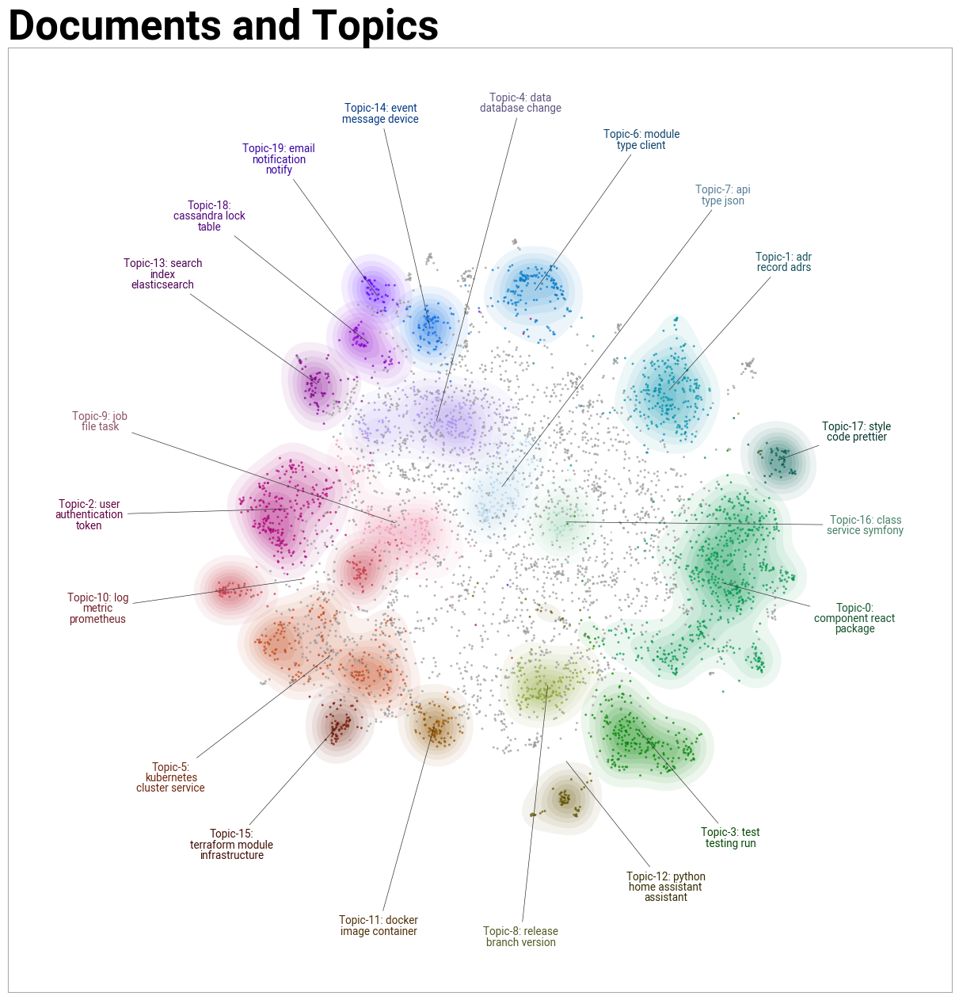

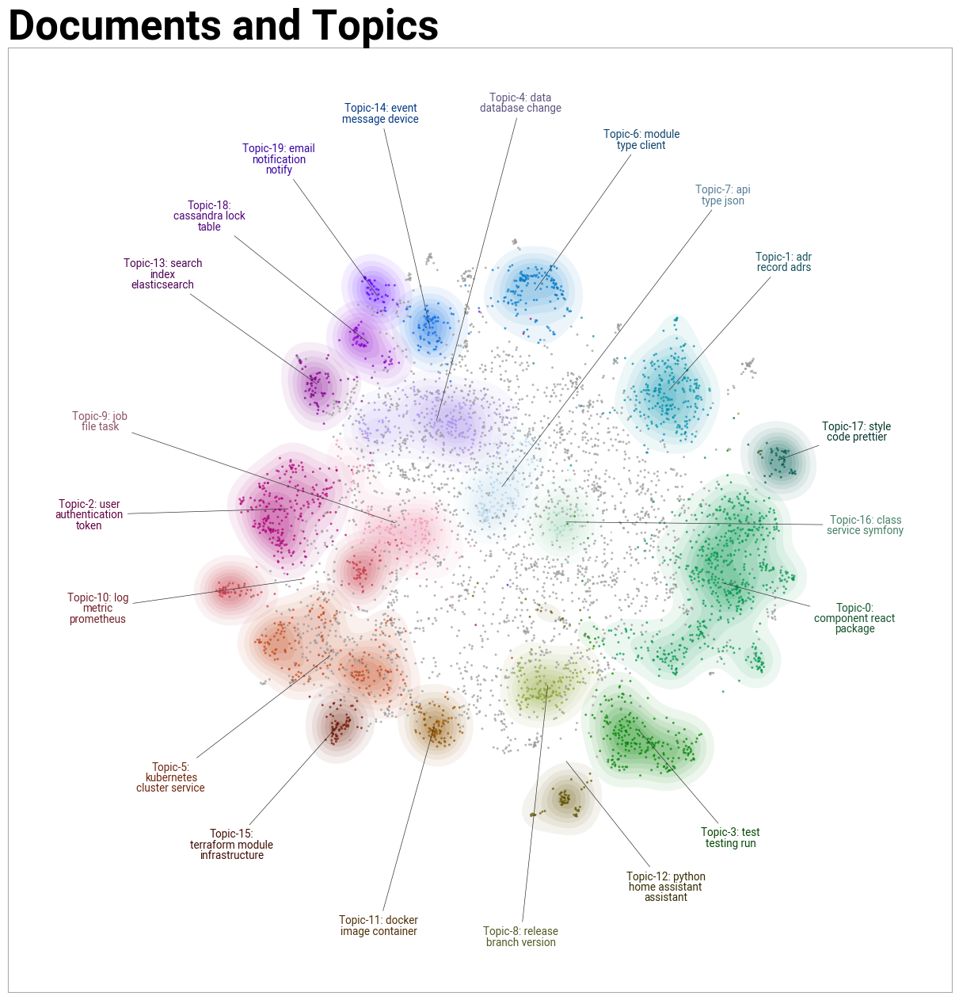

In [15]:
bert_topic_1.visualize_document_datamap(cleaned_texts, embeddings=embeddings)

In [16]:
bert_topic_1.visualize_hierarchy()

## Wordclouds

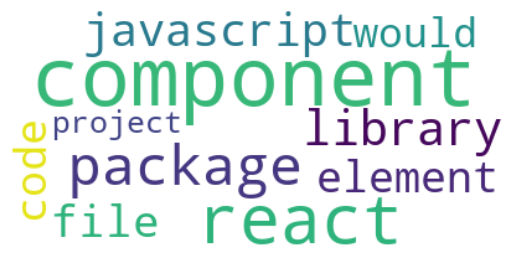

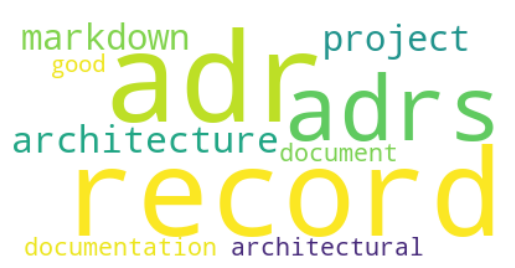

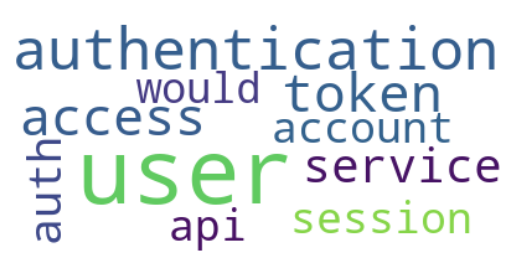

In [17]:
from wordcloud import WordCloud
import matplotlib.pyplot as plt

def create_wordcloud(model, topic):
    text = {word: value for word, value in model.get_topic(topic)}
    wc = WordCloud(background_color="white", max_words=1000)
    wc.generate_from_frequencies(text)
    plt.imshow(wc, interpolation="bilinear")
    plt.axis("off")
    plt.show()

for i in range(3):
    create_wordcloud(bert_topic_1, i)

# Term search in topics

In [18]:
import random
search_terms = ["security", "aws", "cloud",
                "database", "encryption", "network", "server",
                "api", "docker", "kubernetes" , "module" , "connectors",
                "authentication", "authorization", "http" , "testing", "javascript"
                "frontend", "backend", "fullstack", "devops", "agile", "scrum",
                "data", "bigdata", "analytics", "machinelearning", "database"]

search_term = random.choice(search_terms)
print(f"Search Term: {search_term}")
print("Most similar topics:")
similar_topics, similarity = bert_topic_1.find_topics(search_term=search_term, top_n=3)
for topic, sim in zip(similar_topics, similarity):
    print("----------------------------------------------")
    print(f"Topic {topic} with similarity {sim}")
    print("Main KeyBert Representation:")
    print(bert_topic_1.get_topic(topic, full=True)["Main"][:3])
    print("OpenAI Representation:")
    print(bert_topic_1.get_topic(topic, full=True)["Keywords"])

Search Term: encryption
Most similar topics:
----------------------------------------------
Topic 2 with similarity 0.28330540657043457
Main KeyBert Representation:
[('user', 0.041804390352397434), ('authentication', 0.021579742959548766), ('token', 0.017683579948714064)]
OpenAI Representation:


KeyError: 'Keywords'

## Reduce outliers

- Around 2000 documents are not assigned to topics. 

- These are outliers and may be derived from strict hyperparameters for example when using a high min_cluster_size in HDBSCAN. They could also be a result of the low number of clusters as our ADRs are generally diverse in nature.

- We can reduce them and improve the topic quality by calling `reduce_outliers()`. For better results we will use the precalculated probabilites of each document to belong to a specific topic with a minimum defined threshold.

In [42]:
new_topics = bert_topic_1.reduce_outliers(cleaned_texts, topics, probabilities=probs, 
                             threshold=0.05, strategy="probabilities")
# add representation model if needed
bert_topic_1.update_topics(cleaned_texts, topics=new_topics)

2024-06-18 16:06:21,496 - BERTopic - WARNING: Using a custom list of topic assignments may lead to errors if topic reduction techniques are used afterwards. Make sure that manually assigning topics is the last step in the pipeline.Note that topic embeddings will also be created through weightedc-TF-IDF embeddings instead of centroid embeddings.


In [43]:
bert_topic_1.get_topic_info()

,Topic,Count,Name,Representation,Representative_Docs
0,-1,741,-1_data_user_api_file,"[data, user, api, file, service, new, time, co...",[adr extending relationship field allow record...
1,0,775,0_component_react_package_library,"[component, react, package, library, file, cod...",[publish component statusaccepted proposed abl...
2,1,273,1_adr_record_adrs_architecture,"[adr, record, adrs, architecture, project, mar...",[record architecture work cloud platform make ...
3,2,245,2_user_authentication_token_access,"[user, authentication, token, access, service,...",[determine new authentication system open appa...
4,3,229,3_test_testing_run_unit,"[test, testing, run, unit, code, integration, ...",[title follow test pyramid area productoperati...
5,4,471,4_data_database_service_content,"[data, database, service, content, change, api...",[architecture record database migration genera...
6,5,457,5_cluster_service_kubernetes_aws,"[cluster, service, kubernetes, aws, secret, po...",[kubernetes cluster per environment scope web ...
7,6,170,6_module_client_type_message,"[module, client, type, message, node, chain, k...",[adr core module api changelog first draft fir...
8,7,203,7_api_type_error_json,"[api, type, error, json, property, response, v...",[adrapidocumentation title api documentation g...
9,8,336,8_release_branch_feature_repository,"[release, branch, feature, repository, change,...",[new release process updating release process ...


In [44]:
bert_topic_1.visualize_documents(cleaned_texts, embeddings=embeddings)

## Outlier Export

In [45]:
df = pd.DataFrame({"Document": cleaned_texts, "Topic": bert_topic_1.topics_})
df = df[df["Topic"] == -1]
# drop the "topic" column
df.drop(columns=["Topic"], inplace=True)
# convert to a list of strings
outlier_documents = df["Document"].tolist()

# save the outlier documents
with open("outlier_documents.txt", "w") as f:
    for doc in outlier_documents:
        f.write(doc + "\n")

In [ ]:
# hier_topics = bert_topic_1.hierarchical_topics(cleaned_texts)
# tree = bert_topic_1.get_topic_tree(hier_topics=hier_topics)

In [ ]:
# print(tree)

In [ ]:
from graphviz import Digraph

def add_edges_tree(dot, parent, subtree):
    if isinstance(subtree, dict):
        for child, grandchild in subtree.items():
            dot.node(child, child, shape='ellipse', style='filled', fillcolor='lightblue', fontsize='18', width='2', height='2')
            dot.edge(parent, child)
            add_edges_tree(dot, child, grandchild)
    else:
        dot.node(str(subtree), f'{parent} ── Topic: {subtree}', shape='ellipse', style='filled', fillcolor='lightblue', fontsize='18', width='2', height='2')
        dot.edge(parent, str(subtree))

# Reconstruct the topic tree based on the provided structure
updated_topic_tree = {
    "Module API Evolution Decision": {
        "Email Delivery Architecture": 21,
        "Data Abstraction Modeling Strategy": {
            "Data Management System Optimization": 19,
            "Telemetry Metric Collection Strategy": {
                "Messaging Telemetry Collection System": {
                    "Modular System Architecture": {
                        "Messaging System Design Approach": 10,
                        "Module Communication Decisions": 6
                    },
                    "Data Modeling Decisions": {
                        "Data Transformation Strategy": {
                            "Data Storage Decisions": 20,
                            "Access Control Decisions": {
                                "Data Schema Evolution Strategy": {
                                    "API Documentation Strategy": 7,
                                    "Data Structure Transformation Proposal": 5
                                },
                                "User Authentication Architecture": 2
                            }
                        },
                        "Monitoring And Metric Management": 8
                    }
                },
                "Search Indexing Architecture Decision": 11
            }
        }
    },
    "Deployment Configurations Analysis": {
        "Cloud Infrastructure Architecture": {
            "Containerized Application Development": 9,
            "Infrastructure Decisions": {
                "Cloud-Native Architecture Decisions": {
                    "Cluster Traffic Management Strategy": 16,
                    "Cloud Infrastructure Management": 14
                },
                "Infrastructure Management Strategy": 13
            }
        },
        "Modernizing Legacy Code Base": {
            "Software Component Decisions": {
                "Software Development Architectural Decisions": 12,
                "Software Architecture Decisions": {
                    "Test Strategy Evolution": 3,
                    "Code Architecture Decisions": {
                        "Dependency Management Decision": {
                            "Component Library Implementation Strategy": {
                                "Modular Architecture Decisions": 15,
                                "Component Architecture Decisions": {
                                    "Library Component Distribution": 0,
                                    "Build System Configuration Decisions": 17
                                }
                            },
                            "Release Process Standardization": 4
                        },
                        "Architecture Decision Records (ADRs)": 1
                    }
                }
            },
            "Code Formatting Decision Strategy": 18
        }
    }
}

# # Initialize the Digraph with adjusted node style
# dot = Digraph(comment='Updated Topic Tree')

# # Adding the root nodes
# for parent, subtree in updated_topic_tree.items():
#     dot.node(parent, parent, shape='ellipse', style='filled', fillcolor='lightblue', fontsize='18', width='2', height='2')
#     add_edges_tree(dot, parent, subtree)

# # Render the graph
# dot.attr(size='10,10')
# dot.attr(rankdir='TB')
# dot.render('updated_topic_tree', format='pdf')



In [ ]:
# topic_df = bert_topic_1.get_topic_info()
# topic_df.sort_values("Count", ascending=False)
# # remove topic -1
# topic_df = topic_df[topic_df["Topic"] != -1]
# # change the topic 0 name
# topic = "0_Library component distribution"
# topic_df.loc[topic_df["Name"] == topic, "Name"] = "Frontend component architecture"
# # remove any numbers from the topic names
# topic_df["Name"] = topic_df["Name"].str.replace(r"\d+", "", regex=True).replace("_", " ", regex=True)
# # change topic 1 name
# topic = "data structure transformation proposal"
# topic_df.loc[topic_df["Name"] == topic, "Name"] = "Data transformation proposal"

# topic_df.sort_values("Count", ascending=False)

## Percentage share of topics

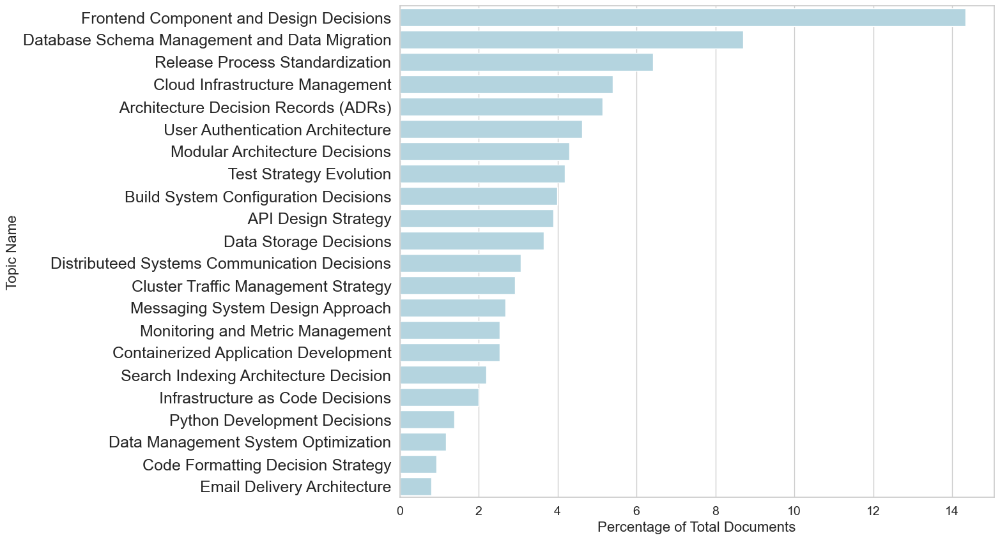

In [27]:
import matplotlib.pyplot as plt
import seaborn as sns

topic_df = pd.read_csv("topic_table.csv")

# Calculate the total count of documents
total_documents_new = 5368  # as specified by the user

# Calculate the percentage share of each topic
topic_df["Percentage"] = (topic_df["ADR Count"] / total_documents_new) * 100

# Sorting the topics by percentage
new_topic_df = topic_df.sort_values("Percentage", ascending=False)

# Plotting the data with the updated topic names
plt.figure(figsize=(12, 10))
sns.set(style="whitegrid")
sns.barplot(x="Percentage", y="LLM Representation Name", data=new_topic_df, color='lightblue')
# increase font
plt.yticks(fontsize=18)
plt.xticks(fontsize=14)
plt.xlabel("Percentage of Total Documents", fontdict={'fontsize': 16})
plt.ylabel("Topic Name", fontdict={'fontsize': 16})
# plt.title("Percentage Share of Documents by Topic")
plt.show()


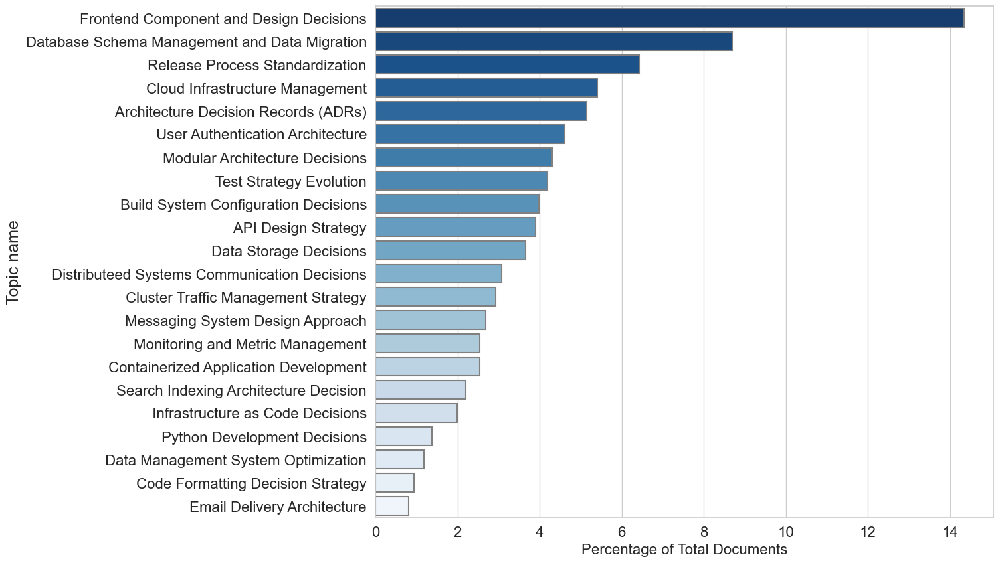

In [30]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Calculate the total count of documents
total_documents_new = 5368  # as specified by the user

# Calculate the percentage share of each topic
topic_df["Percentage"] = (topic_df["ADR Count"] / total_documents_new) * 100

# Sorting the topics by percentage
new_topic_df = topic_df.sort_values("Percentage", ascending=False)

# Create a color palette with shades of blue
colors = sns.color_palette("Blues", len(new_topic_df))[::-1]

# Plotting the data with the updated topic names
plt.figure(figsize=(12, 10))
sns.set(style="whitegrid")
bar_plot = sns.barplot(x="Percentage", y="LLM Representation Name", data=new_topic_df, palette=colors, edgecolor="grey", linewidth=1.5)
bar_plot.set_xlabel("Percentage of Total Documents", fontsize=16)
bar_plot.set_ylabel("Topic name", fontsize=18)

# Increase the font size of the x-axis labels
plt.xticks(fontsize=16)

# Increase the font size of the y-axis labels
bar_plot.set_yticklabels(bar_plot.get_yticklabels(), fontsize=16)

# Show the plot
plt.show()


In [ ]:
topic_df = topic_df.sort_values("Count", ascending=False)
topic_df.iloc[4]["Keywords"]

['architectural record',
 'architecture record',
 'documentation',
 'changelog',
 'record architecture',
 'record architectural',
 'example description',
 'document',
 'architectural',
 'structure']

In [ ]:
new_topic_df

,Topic,Count,Name,Representation,Keywords,Representative_Docs,Percentage
1,0,770,Frontend component architecture,[Library component distribution],"[react, component, typescript, npm, framework,...",[create new react application setting redesign...,14.344262
6,5,467,data structure transformation proposal,[data structure transformation proposal],"[database, schema, sql, metadata, implementati...",[adr supporting nosql backends jean cochrane o...,8.699702
5,4,345,Release Process Standardization,[Release Process Standardization],"[versioning, release note, repository, pull re...",[new release process updating release process ...,6.426975
15,14,290,Cloud Infrastructure Management,[Cloud Infrastructure Management],"[kubernetes, cloud platform, cluster, elastics...",[kubernetes cluster per environment scope web ...,5.402385
2,1,276,Architecture Decision Records (ADRs),[Architecture Decision Records (ADRs)],"[architectural record, architecture record, do...",[documenting architecture architecture agile p...,5.141580
3,2,248,User Authentication Architecture,[User Authentication Architecture],"[access control, authorization, oauth, authent...",[determine new authentication system open appa...,4.619970
16,15,231,Modular Architecture Decisions,[Modular Architecture Decisions],"[implement, interface, implementation, module,...",[drop legacy new code restriction originally p...,4.303279
4,3,225,Test Strategy Evolution,[Test Strategy Evolution],"[test suite, testing framework, unit testing, ...",[title follow test pyramid area productoperati...,4.191505
18,17,214,Build System Configuration Decisions,[Build System Configuration Decisions],"[configuration file, maven, build tool, gradle...",[adr groovy proposed author damir murat damirm...,3.986587
8,7,209,API Documentation Strategy,[API Documentation Strategy],"[api management, apis, api, openapi, schema, e...",[adrapidocumentation title api documentation g...,3.893443


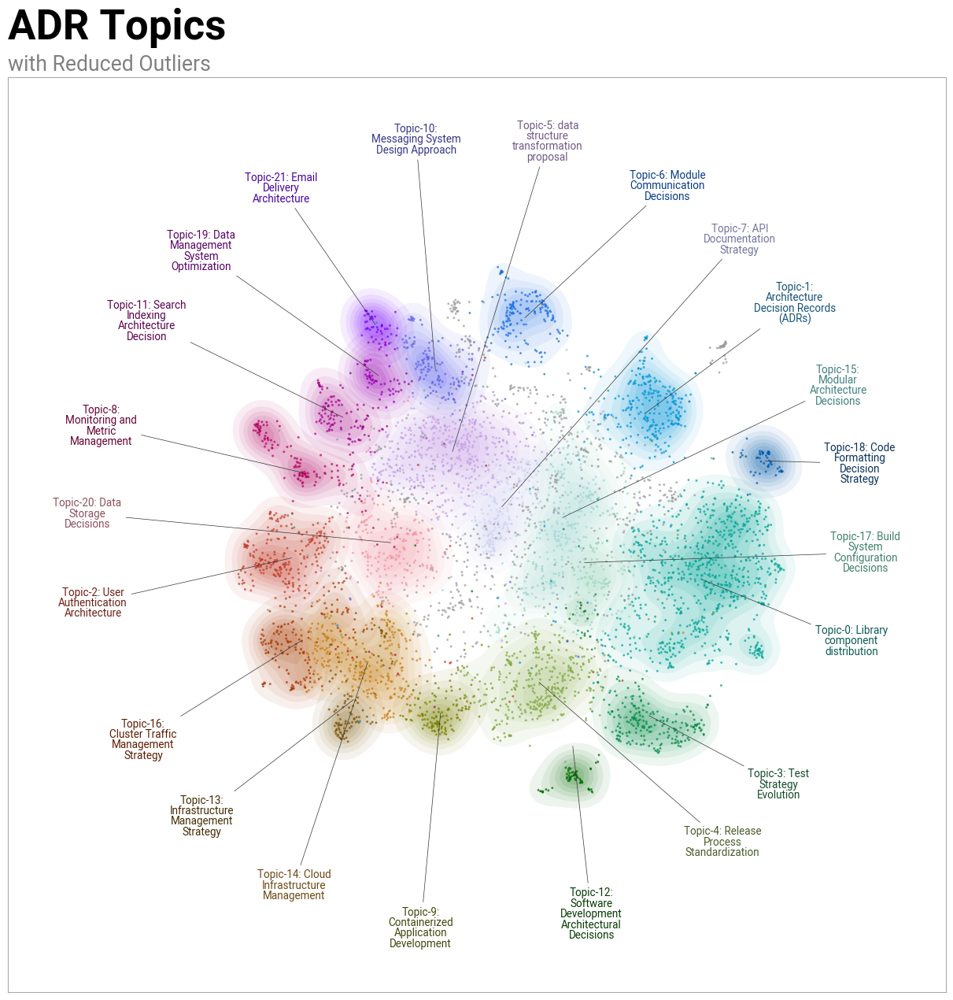

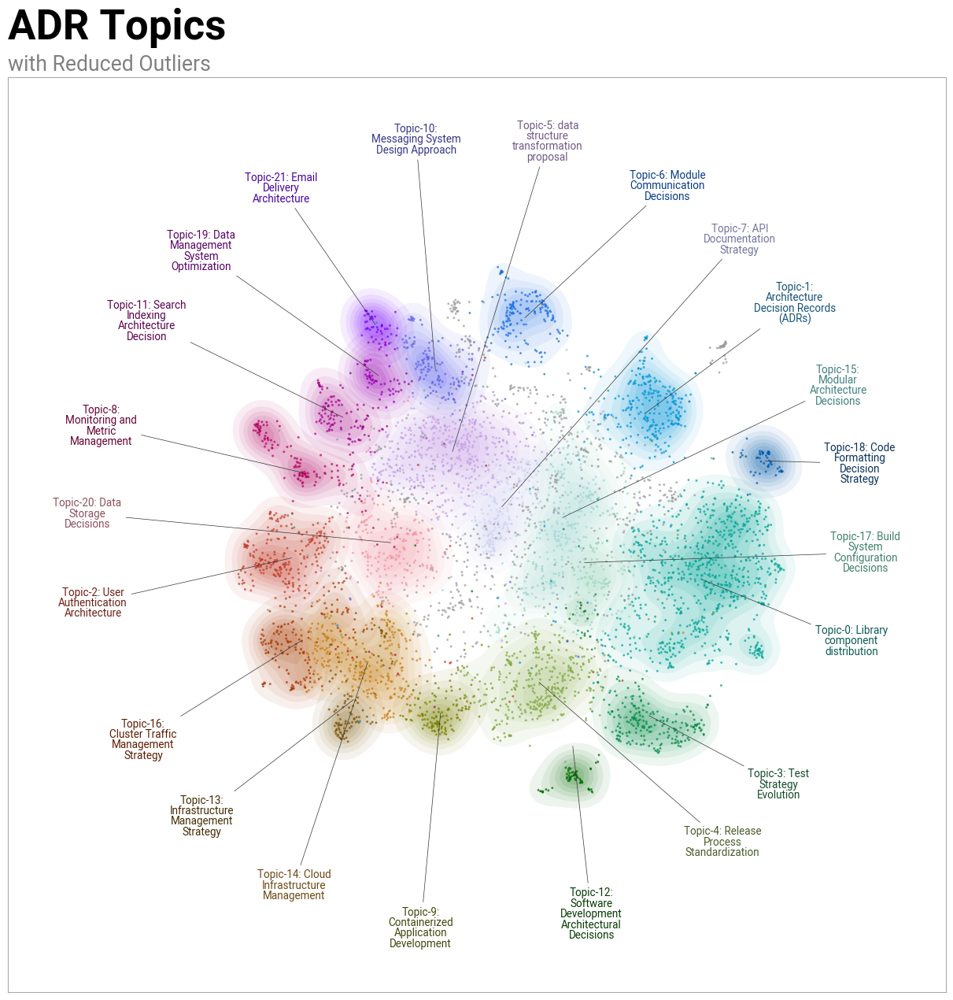

In [ ]:
bert_topic_1.visualize_document_datamap(cleaned_texts, embeddings=embeddings, topics=new_topics,
                                         title="ADR Topics", sub_title="with reduced outliers")

In [ ]:
bert_topic_1.visualize_heatmap()

In [ ]:
bert_topic_1.get_document_info(cleaned_texts)

,Document,Topic,Name,Representation,Keywords,Representative_Docs,Top_n_words,Probability,Representative_document
0,adr react framework frontend development frame...,0,0_Library component distribution,[Library component distribution],"[react, component, typescript, npm, framework,...",[create new react application setting redesign...,Library component distribution,1.000000,False
1,adr libuser october weve decided build user st...,0,0_Library component distribution,[Library component distribution],"[react, component, typescript, npm, framework,...",[create new react application setting redesign...,Library component distribution,0.075532,False
2,data attribute configuring gtm container track...,0,0_Library component distribution,[Library component distribution],"[react, component, typescript, npm, framework,...",[create new react application setting redesign...,Library component distribution,0.074974,False
3,kind architecture record adr create datetime r...,-1,-1_Service API Configuration Decisions,[Service API Configuration Decisions],"[api, endpoint, workflow, service, implement, ...",[firebase infrastructure deciders eimi james a...,Service API Configuration Decisions,0.678391,False
4,title available stock improvement area invento...,-1,-1_Service API Configuration Decisions,[Service API Configuration Decisions],"[api, endpoint, workflow, service, implement, ...",[firebase infrastructure deciders eimi james a...,Service API Configuration Decisions,0.578125,False
...,...,...,...,...,...,...,...,...,...
5363,web controller decide framework web controller...,0,0_Library component distribution,[Library component distribution],"[react, component, typescript, npm, framework,...",[create new react application setting redesign...,Library component distribution,0.214244,False
5364,yaml configuration file order custom adr templ...,17,17_Build System Configuration Decisions,[Build System Configuration Decisions],"[configuration file, maven, build tool, gradle...",[adr groovy proposed author damir murat damirm...,Build System Configuration Decisions,1.000000,False
5365,password sharing secret easi engineer occasion...,14,14_Cloud Infrastructure Management,[Cloud Infrastructure Management],"[kubernetes, cloud platform, cluster, elastics...",[kubernetes cluster per environment scope web ...,Cloud Infrastructure Management,0.064092,False
5366,kind architecture record adr embracing custom ...,0,0_Library component distribution,[Library component distribution],"[react, component, typescript, npm, framework,...",[create new react application setting redesign...,Library component distribution,0.586172,False
